# **HOMEWORK 4**

**Group members:**
* Gabriele Cabibbo 2196717 - cabibbo.2196717@studenti.uniroma1.it
* Paolo Cencia 1963348 - cencia.1963348@studenti.uniroma1.it
* Debora Siri 1921846 - siri.1921846@studenti.uniroma1.it
* Angelica Zauner 1883247 - zauner.1883247@studenti.uniroma1.it

In [ ]:
# Required libraries imports:

import pandas as pd
import numpy as np
import re
import matplotlib.pyplot as plt
import seaborn as sns
import random
from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN
from functions import *
from scipy.spatial.distance import cdist
import random
from sklearn.metrics import davies_bouldin_score, silhouette_score, calinski_harabasz_score

In [ ]:
!kaggle datasets download -d grouplens/movielens-20m-dataset -p /content

Dataset URL: https://www.kaggle.com/datasets/grouplens/movielens-20m-dataset
License(s): unknown
 95% 185M/195M [00:00<00:00, 222MB/s]
100% 195M/195M [00:00<00:00, 222MB/s]


In [ ]:
import zipfile

dataset_path = '/content/movielens-20m-dataset.zip'

with zipfile.ZipFile(dataset_path, 'r') as zip_ref:
    zip_ref.extractall('/content')

print("Extracted Files.")

Extracted Files.


## **1. Recommendation System with LSH**

### **1.1 Data Preparation**

In [ ]:
ratings=pd.read_csv('/content/rating.csv')
movies=pd.read_csv('/content/movie.csv')
tags=pd.read_csv('/content/tag.csv')
links=pd.read_csv('/content/link.csv')
genome_scores=pd.read_csv('/content/genome_scores.csv')
genome_tags=pd.read_csv('/content/genome_tags.csv')

Some info such as the number of records in the tables, the variable types and first rows of each dataset are available below

In [ ]:
print("Info on ratings dataset:\n")
print(ratings.info(),"\n")
print("Total number of Rating dataset rows:",ratings.shape[0],"\n")
print("Info on movies dataset:\n")
print(movies.info(),"\n")
print("Total number of movies dataset rows:",movies.shape[0],"\n")
print("Info on tags dataset:\n")
print(tags.info(),"\n")
print("Total number of tags dataset rows:",tags.shape[0],"\n")
print("Info on links dataset:\n")
print(links.info())
print("Total number of links dataset rows:",links.shape[0],"\n")
print("Info on genome_Scores dataset:\n")
print(genome_scores.info(),"\n")
print("Total number of genome_scores dataset rows:",genome_scores.shape[0],"\n")
print("Info on genome_tags dataset:\n'")
print(genome_tags.info(),"\n")
print("Total number of genome_tags dataset rows:",genome_tags.shape[0])

Info on ratings dataset:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000263 entries, 0 to 20000262
Data columns (total 4 columns):
 #   Column     Dtype  
---  ------     -----  
 0   userId     int64  
 1   movieId    int64  
 2   rating     float64
 3   timestamp  object 
dtypes: float64(1), int64(2), object(1)
memory usage: 610.4+ MB
None 

Total number of Rating dataset rows: 20000263 

Info on movies dataset:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27278 entries, 0 to 27277
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   movieId  27278 non-null  int64 
 1   title    27278 non-null  object
 2   genres   27278 non-null  object
dtypes: int64(1), object(2)
memory usage: 639.5+ KB
None 

Total number of movies dataset rows: 27278 

Info on tags dataset:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 465564 entries, 0 to 465563
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype 
--

In [ ]:
print('First rows of Rating:\n', ratings.head())
print('First rows of Movies:\n',movies.head())
print('First rows of Tags:\n',tags.head())
print('First rows of Links:\n',links.head())
print('First rows of Genome_Scores:\n',genome_scores.head())
print('First rows of Genome_Tags:\n',genome_tags.head())

First rows of Rating:
    userId  movieId  rating            timestamp
0       1        2     3.5  2005-04-02 23:53:47
1       1       29     3.5  2005-04-02 23:31:16
2       1       32     3.5  2005-04-02 23:33:39
3       1       47     3.5  2005-04-02 23:32:07
4       1       50     3.5  2005-04-02 23:29:40
First rows of Movies:
    movieId                               title  \
0        1                    Toy Story (1995)   
1        2                      Jumanji (1995)   
2        3             Grumpier Old Men (1995)   
3        4            Waiting to Exhale (1995)   
4        5  Father of the Bride Part II (1995)   

                                        genres  
0  Adventure|Animation|Children|Comedy|Fantasy  
1                   Adventure|Children|Fantasy  
2                               Comedy|Romance  
3                         Comedy|Drama|Romance  
4                                       Comedy  
First rows of Tags:
    userId  movieId            tag            times



Understand missing values in datasets

In [ ]:
print("Information on missing values of Rating dataset:\n")
print(ratings.isnull().sum(),"\n")
print("Observactions with missing value for Rating dataset:")
print(ratings[ratings.isnull().any(axis=1)],"\n")
print("Information on missing values of movies dataset:")
print(movies.isnull().sum(),"\n")
print("Observactions with missing value for Movies dataset:")
print(movies[movies.isnull().any(axis=1)],"\n")
print("Information on missing values of tags dataset:")
print(tags.isnull().sum(),"\n")
print("Observactions with missing value for Tag dataset:")
print(tags[tags.isnull().any(axis=1)],"\n")
print("Information on missing values of links dataset:")
print(links.isnull().sum(),"\n")
print("Observactions with missing value for Link dataset:")
print(links[links.isnull().any(axis=1)],"\n")
print("Information on missing values of genome_scores dataset:")
print(genome_scores.isnull().sum(),"\n")
print("Observactions with missing value for Genome_Scores dataset:")
print(genome_scores[genome_scores.isnull().any(axis=1)],"\n")
print("Information on missing values of genome_tags dataset:")
print(genome_tags.isnull().sum(),"\n")
print("Observactions with missing value for Genome_Tags dataset:")
print(genome_tags[genome_tags.isnull().any(axis=1)],"\n")

Information on missing values of Rating dataset:

userId       0
movieId      0
rating       0
timestamp    0
dtype: int64 

Observactions with missing value for Rating dataset:
Empty DataFrame
Columns: [userId, movieId, rating, timestamp]
Index: [] 

Information on missing values of movies dataset:
movieId    0
title      0
genres     0
dtype: int64 

Observactions with missing value for Movies dataset:
Empty DataFrame
Columns: [movieId, title, genres]
Index: [] 

Information on missing values of tags dataset:
userId        0
movieId       0
tag          16
timestamp     0
dtype: int64 

Observactions with missing value for Tag dataset:
        userId  movieId  tag            timestamp
373276  116460      123  NaN  2008-01-04 12:47:47
373277  116460      346  NaN  2008-01-04 13:05:46
373281  116460     1184  NaN  2008-01-04 13:11:01
373288  116460     1785  NaN  2008-01-04 13:06:46
373289  116460     2194  NaN  2008-01-04 12:44:37
373291  116460     2691  NaN  2008-01-04 12:50:02
3732

There is only one row with null values in the ratings dataset, no null elements in movies, genome_Scores dataset and genome_tags dataset, 15 rows with null values in the tag variable of the tags dataset and some rows with null values in the tmdbId variable of the links dataset. For the moment I only need to use the ratings and movies datasets. The null value in the ratings dataset affects all variables in a single observation. Therefore it is not necessary to handle this null value unless required by a specific procedure later on.



### **1.2 Minhash Signatures**

In [ ]:
import random
#group movies for each user
movies_list=ratings.groupby('userId')['movieId'].apply(set)
def MinHash_function(movieIds,number_hash_function,p):
    signature=[]
    #set a seed to generate random parameters reproducibles
    random.seed(42)
    #generate a random parameter for each hash function
    list_random_a=random.sample(range(1,1001),number_hash_function)
    #calculate min hash value for each hash function
    for a in list_random_a:
        min=float('inf')
        for ID in movieIds:
            hash_output=(a*ID)%p
            if hash_output<min:
                min=hash_output
        signature.append(min)
    return signature
#generate signatures vector for all users
number_hash_function=10
user_signatures_vector={}
p=7
for userId,movieIds in movies_list.items():
    user_signatures_vector[userId]=MinHash_function(movieIds,number_hash_function,p)



We calculated the MinHash signature for each user as follows:  
we employed the following equation as the MinHash signature:  

$\text{hash_function = (a} \cdot \text{MovieID) % p}$

where $a$ is a random parameter, and $p$ is a chosen prime number.  
In the code we generated the random parameter `a` using a seed to ensure reproducibility. Then, for each *movieID*, we calculated the hash function using different random values of a and selected the minimum output to include in the signature. Finally we saved each user's MinHash signature in a dictionary.  


In [ ]:
movies_list_head=movies_list.head(1000) #sample of movies_list

# test with different number primes as p and different number of hash functions to find the best signatures configuration with higher avg similarity values
signature_test=[]
p_numbers=[7,127,257]  # different p numbers
num_hash_function=[5,10,20]  # different number of hash functions

# calculate user signature vectors for each combination of p and num_hash
for p in p_numbers:
    for num_hash in num_hash_function:
        user_signatures_vector={}
        for userId, movieIds in movies_list_head.items():
            signature=MinHash_function(movieIds, num_hash, p)
            user_signatures_vector[userId]=signature
        # Save user_signature_vectors obtained with different combinations of p and num_hash
        signature_test.append((p, num_hash, user_signatures_vector))


# for each p and num_hash, calculate the average of the Jaccard similarities to find the configuration that maximizes it
for p,num_hash,user_signatures_vector in signature_test:
    sim_jaccard={}
    for user1 in user_signatures_vector:
        for user2 in user_signatures_vector:
            # calculate Jaccard similarity only if user1 is different from user2
            if user1!=user2:
                # Count matching elements
                equal_elements=0
                for i in range(len(user_signatures_vector[user1])):
                    if user_signatures_vector[user1][i]==user_signatures_vector[user2][i]:
                        equal_elements+=1
                # Jaccard similarity = number of equal elements / total number of elements
                sim_jaccard[(user1, user2)] =equal_elements / len(user_signatures_vector[user1])

    mean_sim_jaccard = sum(sim_jaccard.values()) / len(sim_jaccard)
    print(f"Using p={p} and number_hash_function={num_hash} the average of the Jaccard similarities is: {mean_sim_jaccard:.4f}")

Using p=7 and number_hash_function=5 the average of the Jaccard similarities is: 0.9841
Using p=7 and number_hash_function=10 the average of the Jaccard similarities is: 0.9857
Using p=7 and number_hash_function=20 the average of the Jaccard similarities is: 0.9857
Using p=127 and number_hash_function=5 the average of the Jaccard similarities is: 0.3183
Using p=127 and number_hash_function=10 the average of the Jaccard similarities is: 0.3213
Using p=127 and number_hash_function=20 the average of the Jaccard similarities is: 0.3218
Using p=257 and number_hash_function=5 the average of the Jaccard similarities is: 0.1665
Using p=257 and number_hash_function=10 the average of the Jaccard similarities is: 0.1646
Using p=257 and number_hash_function=20 the average of the Jaccard similarities is: 0.1656


We tried with different combination of p and num_hash_function to find the best
signature for each user, using a sample of movies_list consisting of the first 1000 rows. This was necessary because running the experiment on the entire movies_list exceeds the 32GB of RAM available on Kaggle.
For the test first we generated the signature for each user with different p and num_hash_function.
then calculated jaccard similarity for each pair of users and at the end the average of jaccard similarity for each configuration.
We observed that more p number chosen grow, more average jaccard similarity decrease. the employed of different number of hash function doesn't change so much the results

### **1.3 Locality-Sensitive Hashing (LSH)**

In [ ]:
def create_buckets(user_signatures_vector, number_bands):
    import hashlib
    from collections import defaultdict

    # Set number of bands and calculate number of elements per bands
    user_1=list(user_signatures_vector.keys())[0]
    signature_1=user_signatures_vector[user_1]
    number_element_per_band=len(signature_1)//number_bands

    # Create buckets
    buckets={}
    for userId,signature in user_signatures_vector.items():
        for i in range(number_bands):
            start=i*number_element_per_band  # Calculate each times start and end positions to hashing in bands
            end=start+number_element_per_band
            band=signature[start:end]
            bucket_id=hashlib.md5(str(band).encode()).hexdigest()
            # If bucket doesn't exist inizialized it
            if bucket_id not in buckets:
                buckets[bucket_id]=[]
            buckets[bucket_id].append(userId)

    # Show results for first 5 buckets
    for bucket_id,userId in list(buckets.items())[:5]:
        print(f"Bucket ID: {bucket_id}, Users: {userId}")

# example of use
create_buckets(user_signatures_vector, number_bands=5)


Bucket ID: fabf634233b5a4518efdbe074188301b, Users: [1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 7, 7, 7, 7, 7, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 10, 10, 10, 10, 10, 11, 11, 11, 11, 11, 12, 12, 12, 12, 12, 13, 13, 13, 13, 13, 14, 14, 14, 14, 14, 15, 15, 15, 15, 15, 16, 16, 16, 16, 16, 17, 17, 17, 17, 17, 18, 18, 18, 18, 18, 19, 19, 19, 19, 19, 20, 20, 20, 20, 20, 21, 21, 21, 21, 21, 22, 22, 22, 22, 22, 23, 23, 23, 23, 23, 24, 24, 24, 24, 24, 25, 25, 25, 25, 25, 26, 26, 26, 26, 26, 27, 27, 27, 27, 27, 28, 28, 28, 28, 28, 29, 29, 29, 29, 29, 30, 30, 30, 30, 30, 31, 31, 31, 31, 31, 32, 32, 32, 32, 32, 33, 33, 33, 33, 33, 34, 34, 34, 34, 34, 35, 35, 35, 35, 35, 36, 36, 36, 36, 36, 37, 37, 37, 37, 37, 38, 38, 38, 38, 38, 39, 39, 39, 39, 39, 40, 40, 40, 40, 40, 41, 41, 41, 41, 41, 42, 42, 42, 42, 42, 43, 43, 43, 43, 43, 44, 44, 44, 44, 44, 45, 45, 45, 45, 45, 46, 46, 46, 46, 46, 47, 47, 47, 47, 47, 48, 48, 48, 48, 48, 49, 49, 49, 49, 49, 50, 50, 50, 

we have
*   divided the MinHash signature into bands: each signature is divided into a specified number of bands and each band containing the same number of elements
*   calculated unique hash for each band and assigned users to buckets: users sharing the same bands are added to the same bucket
*   verified that users with similar bands were in the same buckets: the first 5 buckets were printed at the end of the code to confirm that users with similar bands were in the same buckets


Before we employed p=7 and num_hash_function=10 because this configuration maximizes the average Jaccard similarity, but with this configuration some buckets are overcrowded, I want try other higher value of p


In [ ]:
#test with p=11, generate minhash signature and then create buckets
user_signatures_vector={}
p=11
for userId,movieIds in movies_list.items():
    user_signatures_vector[userId]=MinHash_function(movieIds,number_hash_function,p)
create_buckets(user_signatures_vector, number_bands=5)


Bucket ID: fabf634233b5a4518efdbe074188301b, Users: [1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 7, 7, 7, 7, 7, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 10, 10, 10, 10, 10, 11, 11, 11, 11, 11, 12, 12, 12, 12, 12, 13, 13, 13, 13, 13, 14, 14, 14, 14, 14, 15, 15, 15, 15, 15, 16, 16, 16, 16, 16, 17, 17, 17, 17, 17, 18, 18, 18, 18, 18, 19, 19, 19, 19, 19, 20, 20, 20, 20, 20, 21, 21, 21, 21, 21, 22, 22, 22, 22, 22, 23, 23, 23, 23, 23, 24, 24, 24, 24, 24, 25, 25, 25, 25, 25, 26, 26, 26, 26, 26, 27, 27, 27, 27, 27, 28, 28, 28, 28, 28, 29, 29, 29, 29, 29, 31, 31, 31, 31, 31, 32, 32, 32, 32, 32, 33, 33, 33, 33, 33, 34, 34, 34, 34, 34, 35, 35, 35, 35, 35, 36, 36, 36, 36, 36, 37, 37, 37, 37, 37, 38, 38, 38, 38, 38, 40, 40, 40, 40, 40, 41, 41, 41, 41, 41, 42, 42, 42, 42, 42, 43, 43, 43, 43, 43, 44, 44, 44, 44, 44, 45, 45, 45, 45, 45, 46, 46, 46, 46, 46, 47, 47, 47, 47, 47, 48, 48, 48, 48, 48, 49, 49, 49, 49, 49, 50, 50, 50, 50, 50, 51, 51, 51, 51, 51, 52, 52, 52, 52, 52, 53, 53,

In [ ]:
#test with p=23, generate minhash signature and then create buckets
user_signatures_vector={}
p=23
for userId,movieIds in movies_list.items():
    user_signatures_vector[userId]=MinHash_function(movieIds,number_hash_function,p)
create_buckets(user_signatures_vector, number_bands=5)

Bucket ID: fabf634233b5a4518efdbe074188301b, Users: [1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 7, 7, 7, 7, 7, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 10, 10, 10, 10, 10, 11, 11, 11, 11, 11, 12, 12, 12, 12, 12, 13, 13, 13, 13, 13, 14, 14, 14, 14, 14, 15, 15, 15, 15, 15, 16, 16, 16, 16, 16, 17, 17, 17, 17, 17, 18, 18, 18, 18, 18, 19, 19, 19, 19, 19, 21, 21, 21, 21, 21, 22, 22, 22, 22, 22, 23, 23, 23, 23, 23, 24, 24, 24, 24, 24, 25, 25, 25, 25, 25, 26, 26, 26, 26, 26, 27, 27, 27, 27, 27, 28, 28, 28, 28, 28, 29, 29, 29, 29, 29, 30, 30, 30, 30, 30, 31, 31, 31, 31, 31, 32, 32, 32, 32, 32, 33, 33, 33, 33, 33, 34, 34, 34, 34, 34, 35, 35, 35, 35, 35, 38, 38, 38, 38, 38, 39, 39, 39, 39, 39, 40, 40, 40, 40, 40, 41, 41, 41, 41, 41, 42, 42, 42, 42, 42, 43, 43, 43, 43, 43, 44, 44, 44, 44, 44, 45, 45, 45, 45, 45, 46, 46, 46, 46, 46, 47, 47, 47, 47, 47, 48, 48, 48, 48, 48, 50, 50, 50, 50, 50, 51, 51, 51, 51, 51, 52, 52, 52, 52, 52, 53, 53, 53, 53, 53, 54, 54, 54, 

We decided to use the configuration p=11 for the MinHash signature because higher
p values increase the number of buckets with only one element and decrease the average Jaccard similarity without providing any benefit. We observed some overcrowded buckets, the hypothesis is that many users watch approximately the same films.

In [ ]:

from collections import Counter
def two_most_similar_users(given_user,buckets):
    #save in user_buckets all buckets's ID that contain the given_user
    buckets_ID_shared=[]
    for bucket_id,userId in buckets.items():
      if given_user in userId:
        buckets_ID_shared.append(bucket_id)
    #save in similar_users all users present in the same buckets where the given_user is present
    similar_users=[]
    for bucket_id in buckets_ID_shared:
      for userid in buckets[bucket_id]:
        if userid!=given_user:
            similar_users.append(userid)
    #count how many times each user appears in the buckets shared with the given_user
    user_counts=Counter(similar_users)
    #sort users frequencies in descending order and take the two top similar users to given user
    most_similar=user_counts.most_common(2)
    #maintain in most_similar_users only userIds of the two top similar users
    most_similar_users=[]
    for userId,frequencies in most_similar:
      most_similar_users.append(userId)
    return most_similar_users

#Example of use
given_user= 1 #change the userID here to find the two most similar users to the specified user
similar_userss=two_most_similar_users(given_user, buckets)
print(f"Users most similar to {given_user}: {similar_userss}")


Users most similar to 1: [2, 3]


we have find the two most similar users to a specified user (`given_user`) as follow:
1. **find bucket shared**: identify all buckets that contain the given_user.
2. **collect all users in shared bucket**: excluding the `given_user`
3. **frequencies of users in shared buckets**: how many times each users appear in shared buckets
4. **find two most similar user**: sort frequencies in descending order and select the two top Id, they are the two most similar users

In [ ]:

def movie_recommendation(user_id,similar_users,ratings,top_rated=5):
    #save in user1 and user2 the Ids of two most similar users
    user1,user2=similar_userss[0],similar_userss[1]
    #save the list of movieIds and their ratings for user1 and user2
    user1_ratings=ratings[ratings['userId']==user1][['movieId','rating']]
    user2_ratings=ratings[ratings['userId']==user2][['movieId','rating']]
    #inner join between user1_ratings and user2_ratings
    commonly_rated_movies=pd.merge(user1_ratings,user2_ratings,on='movieId')
    if not commonly_rated_movies.empty:
        #if there are observations in common, create 'avg_rating' variable with average rating and mantain only movieId and avg_rating in output dataset sorted in descending order by 'avg_rating'
        commonly_rated_movies['avg_rating']=(commonly_rated_movies['rating_x']+commonly_rated_movies['rating_y'])/2
        recommend_movies=commonly_rated_movies[['movieId', 'avg_rating']].sort_values(by='avg_rating', ascending=False).head(top_rated)
    else:#if there aren't observations in common, maintain movies and rating of user1 sorted in descending order by rating variable
        recommend_movies=user1_ratings.sort_values(by='rating', ascending=False).head(top_rated)
    return recommend_movies

# Example of use
recommend_movies=movie_recommendation(1,similar_userss,ratings,top_rated=5)
print(recommend_movies)


   movieId  avg_rating
0      260         5.0
1      480         5.0
2      541         5.0
4      924         5.0
5     1196         5.0


In [ ]:
print(similar_userss)

[2, 3]


We have to suggest some movies that could be like to the given user, to achieve this we have:
1. extract the list of movie IDs and ratings rated by the two most similar users to the given user
2. done an inner join on the ratings dataset of user1 and user2 to identify movies rated by both users. If the intersection isn't empty we calculated the average raiting for each common movie and we suggest (to the given user) the first movies of this set, together with avg_raiting of each movies until to reach the number of recommended movies equal to *top_rated*
3. If there aren't movies rated by both users, we suggest the first movies were rated better from the first similar user, sorted in descending order by 'rating' until to reach the number of recommended movies equal to *top_rated*


In [ ]:

def final_recommendation(user_id, similar_users, ratings, movies, top_n=5):
    #save in user1 and user2 the Ids of two most similar users
    user1, user2=similar_users[0],similar_users[1]

    #save the list of movieIds and their ratings for user1 and user2
    user1_ratings=ratings[ratings['userId'] == user1][['movieId','rating']]
    user2_ratings=ratings[ratings['userId'] == user2][['movieId','rating']]
    #inner join between user1_ratings and user2_ratings
    commonly_rated_movies=pd.merge(user1_ratings,user2_ratings,on='movieId')
    #create 'avg_rating' variable with average rating and sorted dataset in descending order by 'avg_rating'
    commonly_rated_movies['avg_rating']=(commonly_rated_movies['rating_x']+commonly_rated_movies['rating_y'])/2
    commonly_rated_movies=commonly_rated_movies.sort_values(by='avg_rating',ascending=False).head(top_n)
    #select top rated movies for user1 and user2
    top_rated_user_1=user1_ratings.sort_values(by='rating',ascending=False).head(top_n)
    top_rated_user_2=user2_ratings.sort_values(by='rating', ascending=False).head(top_n)

    #start to combine movies in commons and top-rated movies for each users, avoiding duplicates
    recommend_movies=commonly_rated_movies[['movieId','avg_rating']].copy()
    recommend_movies=recommend_movies.rename(columns={'avg_rating':'rating'})
    for top_rated in [top_rated_user_1,top_rated_user_2]:
    #remaining_movies contain only movies_id in top_rated not present in recommend_movies
      remaining_movies=top_rated[~top_rated['movieId'].isin(recommend_movies['movieId'])]
    #calculate the number of movies needed to reach top_n recommendations
      length_remaining=top_n-len(recommend_movies)
    #select the first length_remaining of movies from remaining_movies
      remaining_movies=remaining_movies.head(length_remaining)
    #Concatenate remaining_movies to recommend_movies dataframe
      recommend_movies=pd.concat([recommend_movies,remaining_movies[['movieId','rating']]])
    #Done left join to add movie titles from the movies dataframe to recommend_movies
      recommend_movies=recommend_movies.merge(movies[['movieId','title']],on='movieId',how='left')


    return recommend_movies.head(top_n)

#example of use
recommend_movies = final_recommendation(1, similar_userss, ratings, movies, top_n=5)
print(recommend_movies)


   movieId  rating                                            title_x  \
0      260     5.0          Star Wars: Episode IV - A New Hope (1977)   
1      480     5.0                               Jurassic Park (1993)   
2      541     5.0                                Blade Runner (1982)   
3      924     5.0                       2001: A Space Odyssey (1968)   
4     1196     5.0  Star Wars: Episode V - The Empire Strikes Back...   

                                             title_y  
0          Star Wars: Episode IV - A New Hope (1977)  
1                               Jurassic Park (1993)  
2                                Blade Runner (1982)  
3                       2001: A Space Odyssey (1968)  
4  Star Wars: Episode V - The Empire Strikes Back...  



We have to suggest some movies that could be like to the given user. This process is similar to the previous step but introduces enhancements. To achieve this, we have:

1. extract the list of movie IDs and ratings from the two most similar users to the given user.

2. done an inner join on the ratings datasets of user1 and user2 to identify movies rated by both users. For these common movies calculate the average rating and save it in the avg_rating variable.

3. sorted the movies rated by the two most similar users in descending order of their ratings. From this sorted set, select up to `top_n` ratings.

4. formed the set of recommended movies for the given user as follows:

    4.1.  First, selected the top-rated common movies (rated by both similar users) along with their avg_rating information, until the total number of movies reaches at most `top_n`.

    4.2. If the number of selected movies is less than `top_n`, filled the remaining slots with the top-rated movies from the most similar user (user1), and then from the other similar user (user2), avoiding duplicates

    4.3. Added the movie titles to the list of recommended movies by performing a left join with the movies DataFrame.

    4.4. Added the information movie's title thanks to a left join with `movies` dataframe

5. Finally we recommend at most `top_n` movies to the given user including each movie's movieId, title and rating.



## **2. Grouping Movies Together!**

### **2.1 Feature Engineering**

The first step is to better represent the features of the movies.

In particular:

<br>

- Firstly, we **separate thr movie title from the year**:

In [ ]:
import re

# Separate movie title from the year it was published and create new column 'year'
movies['year'] = movies['title'].apply(lambda x: re.search(r'\((\d{4})\)', x).group(1) if re.search(r'\((\d{4})\)', x) else np.nan)
movies['title'] = movies['title'].str.replace(r'\s*\(\d{4}\)', '', regex=True)
movies.head()

,movieId,title,genres,year
0,1,Toy Story,Adventure|Animation|Children|Comedy|Fantasy,1995
1,2,Jumanji,Adventure|Children|Fantasy,1995
2,3,Grumpier Old Men,Comedy|Romance,1995
3,4,Waiting to Exhale,Comedy|Drama|Romance,1995
4,5,Father of the Bride Part II,Comedy,1995


In [ ]:
print(f"Null movie years: {movies['year'].isnull().sum()}")
print(f"Null movie titles: {movies['title'].isnull().sum()}")

Null movie years: 22
Null movie titles: 0


<br>

- We **drop** movies with null `year`.

In [ ]:
print(f"Number of rows in movie before removing null years: {movies.shape[0]}")
movies = movies.dropna()
print(f"Number of rows in movie after removing null years: {movies.shape[0]}")

# Convert year from sting to int
movies.loc[:, 'year'] = movies['year'].astype(int)

Number of rows in movie before removing null years: 27278
Number of rows in movie after removing null years: 27256


<br>

- We now **preprocess genres** to have a better representation

In [ ]:
# Converting the 'genres' elements from strings to lists
movies['genre_list'] = movies['genres'].str.split('|')
movies.head()

,movieId,title,genres,year,genre_list
0,1,Toy Story,Adventure|Animation|Children|Comedy|Fantasy,1995,"[Adventure, Animation, Children, Comedy, Fantasy]"
1,2,Jumanji,Adventure|Children|Fantasy,1995,"[Adventure, Children, Fantasy]"
2,3,Grumpier Old Men,Comedy|Romance,1995,"[Comedy, Romance]"
3,4,Waiting to Exhale,Comedy|Drama|Romance,1995,"[Comedy, Drama, Romance]"
4,5,Father of the Bride Part II,Comedy,1995,[Comedy]


<br>

- We **compute the rating average by users for each movie**

In [ ]:
# Compute average rating by users from the movie
grouped_ratings = ratings[['movieId', 'rating']].groupby(['movieId']).mean()
grouped_ratings.reset_index(inplace=True)

grouped_ratings.head()

,movieId,rating
0,1,3.921240
1,2,3.211977
2,3,3.151040
3,4,2.861393
4,5,3.064592


<br>

- We **find most relevant tag given to the movie in the genome set**

In [ ]:
# Find the most relevant tag to a movie
grouped_scores = genome_scores.loc[genome_scores.groupby('movieId')['relevance'].idxmax()]

# Check if tags match and then join grouped scores and genome tags
relevant_tags = grouped_scores[grouped_scores['tagId'].isin(genome_tags['tagId'])].merge(genome_tags.set_index('tagId'), on='tagId', how='left')
relevant_tags = relevant_tags.rename(columns={'tag':'most_relevant_tag'})
relevant_tags['most_relevant_tag'] = relevant_tags['most_relevant_tag'].str.lower()

relevant_tags.head()

,movieId,tagId,relevance,most_relevant_tag
0,1,1036,0.99925,toys
1,2,29,0.98100,adventure
2,3,451,0.97450,good sequel
3,4,1116,0.97675,women
4,5,451,0.96575,good sequel


<br>

- We **find the most common tag given to the movie by the users**

In [ ]:
# Convert tags to lowercase
tags['tag'] = tags['tag'].str.lower()

# Group movies by Id and tag and count how many times a tag has been associated with a movie
grouped_tags = tags.groupby(['movieId', 'tag']).size().reset_index(name='count')

# Find most common tag for each movie
most_common_tags = grouped_tags.loc[grouped_tags.groupby('movieId')['count'].idxmax()]

most_common_tags = most_common_tags.rename(columns={'tag':'most_common_tag', 'count':'n_most_common_tag'})
most_common_tags.head()

,movieId,most_common_tag,n_most_common_tag
51,1,pixar,79
106,2,robin williams,20
121,3,moldy,2
128,4,characters,2
143,5,steve martin,4


<br>

- Finally, we **create a DataFrame** with all the features computed

In [ ]:
# Create a temporary DataFrame with the columns of interest from the movie DataFrame
temp = pd.DataFrame(data = movies[['movieId', 'title', 'genre_list', 'year']], columns=['movieId', 'title', 'genre_list', 'year'])

# Merge in the temporary DataFrame the relevant features created above
df = temp.merge(grouped_ratings, on = 'movieId', how='left').merge(relevant_tags[['most_relevant_tag', 'movieId']], on = 'movieId', how='left').merge(most_common_tags, on = 'movieId', how='left')
df = df.rename(columns={'genre_list':'genres'})

print(f'Shape: {df.shape}')
df.head()

Shape: (27256, 8)


,movieId,title,genres,year,rating,most_relevant_tag,most_common_tag,n_most_common_tag
0,1,Toy Story,"[Adventure, Animation, Children, Comedy, Fantasy]",1995,3.921240,toys,pixar,79.0
1,2,Jumanji,"[Adventure, Children, Fantasy]",1995,3.211977,adventure,robin williams,20.0
2,3,Grumpier Old Men,"[Comedy, Romance]",1995,3.151040,good sequel,moldy,2.0
3,4,Waiting to Exhale,"[Comedy, Drama, Romance]",1995,2.861393,women,characters,2.0
4,5,Father of the Bride Part II,[Comedy],1995,3.064592,good sequel,steve martin,4.0


<br>

#### **Additional features**

We include the following features to gain further insights:

- `n_most_common_tag`: The number of times the most common tag was assigned to the movie (calculated by identifying the most frequently given tag by users);

- `n_ratings`: The total number of ratings received by the movie;

- `n_tags`: The total number of tags assigned to the movie (considering repetitions).

In [ ]:
# Create 'n_ratings' as the total number of rating received by a movie
group_n_ratings = ratings[['movieId', 'rating']].groupby(['movieId']).count()
group_n_ratings.reset_index(inplace=True)
group_n_ratings = group_n_ratings.rename(columns={'rating':'n_ratings'})

group_n_ratings.head()

,movieId,n_ratings
0,1,49695
1,2,22243
2,3,12735
3,4,2756
4,5,12161


In [ ]:
# Create 'n_tags' as the total number of tags received by a movie
group_tag = tags.groupby('movieId')['tag'].count().reset_index(name='n_tags')

group_tag.head()

,movieId,n_tags
0,1,436
1,2,123
2,3,18
3,4,6
4,5,22


In [ ]:
# Merge the new features into the DataFrame
df = df.merge(group_n_ratings, on='movieId', how='left').merge(group_tag, on='movieId', how='left')
df.head()

,movieId,title,genres,year,rating,most_relevant_tag,most_common_tag,n_most_common_tag,n_ratings,n_tags
0,1,Toy Story,"[Adventure, Animation, Children, Comedy, Fantasy]",1995,3.921240,toys,pixar,79.0,49695.0,436.0
1,2,Jumanji,"[Adventure, Children, Fantasy]",1995,3.211977,adventure,robin williams,20.0,22243.0,123.0
2,3,Grumpier Old Men,"[Comedy, Romance]",1995,3.151040,good sequel,moldy,2.0,12735.0,18.0
3,4,Waiting to Exhale,"[Comedy, Drama, Romance]",1995,2.861393,women,characters,2.0,2756.0,6.0
4,5,Father of the Bride Part II,[Comedy],1995,3.064592,good sequel,steve martin,4.0,12161.0,22.0


<br>

**Checking and imputing missing values**

In [ ]:
# Number of missing values for each column in the DataFrame
df.isnull().sum()

,0
movieId,0
title,0
genres,0
year,0
rating,534
most_relevant_tag,16876
most_common_tag,7719
n_most_common_tag,7719
n_ratings,534
n_tags,7719


<br>

**Imputing missing values in `rating`, `n_ratings` and `n_tags`.**

In [ ]:
# Impute the rating with the mean of the ratings, same with the missing number of ratings and the number of tags
df['rating'] = df['rating'].fillna(df['rating'].mean())
df['n_ratings'] = df['n_ratings'].fillna(int(df['n_ratings'].mean())).astype(int)
df['n_tags'] = df['n_tags'].fillna(df['n_tags'].mean()).astype(int)

<br>

**Changing null values in `most_common_tag` and to `most_relevant_tag` to 'unknown' and setting their `n_most_common_tag` to 0.**

In [ ]:
df['most_common_tag'] = df['most_common_tag'].fillna('unknown')
df['most_relevant_tag'] = df['most_relevant_tag'].fillna('unknown')

df['n_most_common_tag'] = df['n_most_common_tag'].fillna(int(0))

<br>

#### **Preprocessing of the categorical variables**

- Preprocess the genres feature to make it suitable for clustering using *One-Hot-Encoding*.

In [ ]:
# One-Hot-Encoding for genre list
genres = set(genre for genre_list in df['genres'] for genre in genre_list)
for genre in genres:
    df[genre] = df['genres'].apply(lambda x: 1 if genre in x else 0)
df = df.drop(labels='genres', axis = 1)

<br>

- Preprocessing `most_relevant_tag` and `most_common_tag` using a dictionary to assign a numeric value to each tag and making sure that the same tags in the two columns have the same value.

In [ ]:
most_relevant = set(df['most_relevant_tag'].str.lower())
most_relevant = most_relevant.union(set(df['most_common_tag'].str.lower()))
most_relevant = {k:v for v,k in enumerate(most_relevant)}
df['most_relevant_tag'] = df['most_relevant_tag'].map(most_relevant)
df['most_common_tag'] = df['most_common_tag'].map(most_relevant)

<br>

### **2.2 Choose your features (variables)!**


##### **1. What is the importance of normalizing the data in your analysis, and how does it impact the effectiveness of the clustering algorithms you plan to use?**

Normalizing data is crucial when we have features measured with different scales.

This could improve the effectiveness of a *KMeans* algorithm because distances computed on normalized variables are **more significant** that distances computed between sizes with different measure scales.

##### **2. If you find that normalizing the values is beneficial, please proceed to normalize the data. To simplify this task, refer to the scikit-learn package for tools and functions that facilitate data normalization.**

After applying clustering on the the data preprocessed in different ways, we concluded that, in this case, normalizing the data isn't beneficial since better results are obtained if we applied our clustering algorithm to the dimensional reduced data using the Principal Component Analysis.

##### **3. Could you provide some insights on dimensionality reduction? What techniques would be effective for reducing the number of features in the dataset, and why might this be beneficial for the analysis?**


Dimensionality reduction techniques are unsupervised learning methods that aim to **represent high dimensional data in a lower dimensional space** while avoiding to lose much information.

A technique that resulted effective to reduce the number of features in the dataset was the **Principal Component Analysis (PCA)**. In fact, in the next cells, we can observe how 3 principal components are able to **explain all the variance in the dataset** and that clustering the lower dimensional dataset, brings to the creation of clusters that are sufficiently acceptable in terms of Average Silhouette Score.

The use of PCA before clustering enables to ignore redundant features and makes the visualization of the clusters easier.

##### **4. If you believe dimensionality reduction would be advantageous, please select a method to reduce the dimensionality of the data.**

In [ ]:
df = df.drop(columns=['title', 'movieId'])

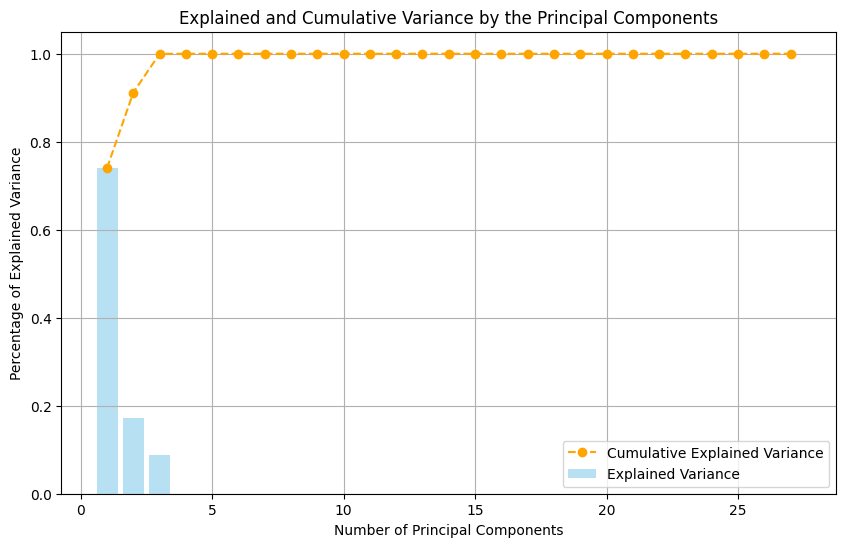

In [ ]:
pca = PCA(random_state=42)
pca.fit(df)

explained_variance = pca.explained_variance_ratio_

# Compute the cumulative explained variance
cumulative_variance = np.cumsum(explained_variance)

# Plot
plt.figure(figsize=(10, 6))
plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.6, label='Explained Variance', color='skyblue')
plt.plot(range(1, len(cumulative_variance) + 1), cumulative_variance, marker='o', linestyle='--', color='orange', label='Cumulative Explained Variance')

plt.xlabel('Number of Principal Components')
plt.ylabel('Percentage of Explained Variance')
plt.title('Explained and Cumulative Variance by the Principal Components')
plt.legend(loc='best')
plt.grid(True)
plt.show()

pca = PCA(n_components=3)

# Apply PCA
df_pca = pca.fit_transform(df)
df_pca = pd.DataFrame(df_pca, columns = ['PC1', 'PC2','PC3'])

In [ ]:
df_pca.head()

,PC1,PC2,PC3
0,48985.892116,2220.806988,-458.920939
1,21418.014846,-2314.885660,-2824.575569
2,11926.709027,-2655.146909,-1317.308091
3,2050.684649,828.894918,1858.801060
4,11421.465961,2569.572616,-1925.939654


### **2.3 Clustering**

##### **2.3.1 How can you determine the optimal number of clusters for your data? Please use at least two methods and provide their results.**

Two common methods to determine the optimal number of clusters are **Elbow Method** and **Silhouette Score**.


- **Elbow Method:** This method involves computing and plotting the sum of the squared distances within clusters (*inertia*) as a function of the number of clusters.

  The idea is to identify an "*elbow* " in the graph, that is, the point at which the reduction in explained variance begins to slow down significantly. The number of clusters corresponding to this point is considered **optimal**.



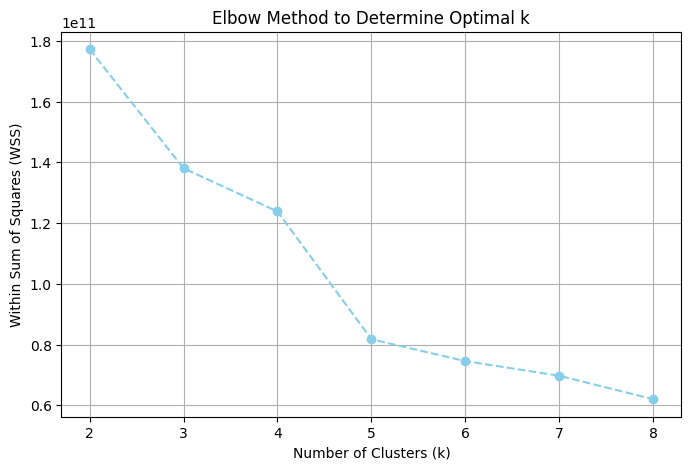

In [ ]:
elbow(df_pca, max_k = 8, seed=42)

- **Silhouette Score:** This is a metric that measures how well each data point fits into its assigned cluster. It combines information about *how close a point is to others in the same cluster* and *how far a point is from points in different clusters*.

  A higher silhouette score indicates that the data points are well-clustered, whereas lower values suggest that the clustering may be less accurate, with overlapping clusters or points that are not well-assigned to their respective clusters.

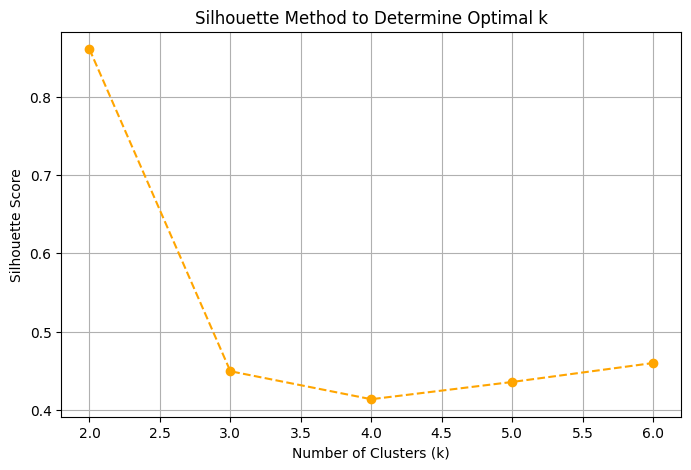

In [ ]:
silhouette(df_pca, max_k=6, seed=42)

##### **2.3.2 Implement the K-means clustering algorithm (not K-means++) through MapReduce. We request that you develop the algorithm from scratch based on what you've learned in class and run the algorithm on your data.**


## **K-means**

In [ ]:
centroids_kmeans, clusters, _, __ = kmeans(df_pca, 2, seed=42)

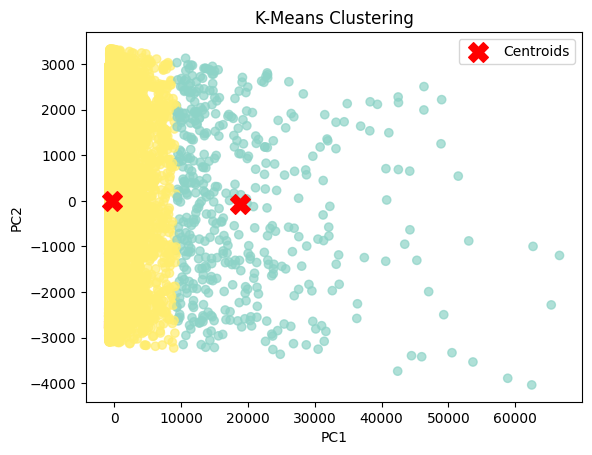

In [ ]:
# Plot kmeans results

plt.scatter(df_pca['PC1'], df_pca['PC2'], c=df_pca['Cluster'], cmap='Set3', marker='o', alpha=0.7)

plt.scatter(centroids_kmeans['PC1'], centroids_kmeans['PC2'], c='red', marker='X', s=200, label='Centroids')

plt.title('K-Means Clustering')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.show()

##### **2.3.3 Implement the K-means++ algorithm from scratch and apply it to your data. Do you notice any differences between the results obtained using random initialization and those achieved with K-means++? Please explain your observations and discuss why these differences might occur.**

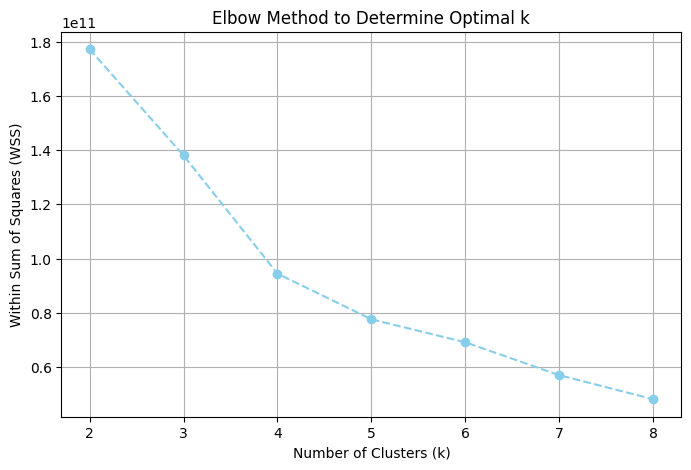

In [ ]:
df_pca.drop(columns=['Cluster'], inplace=True)
elbow(df_pca, max_k = 8, plus=True, seed=42)

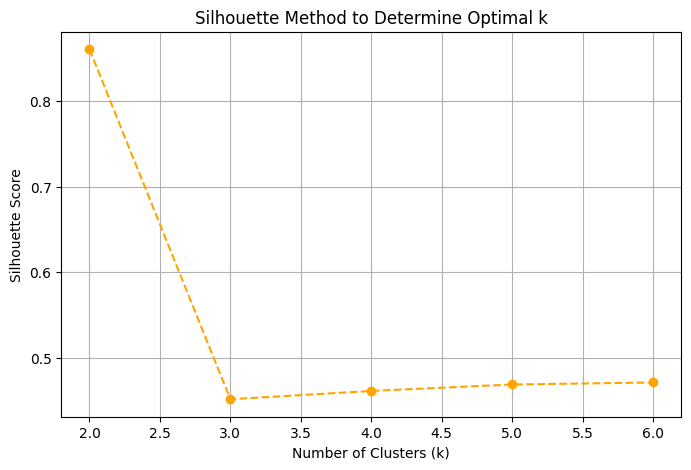

In [ ]:
silhouette(df_pca, max_k=6, plus=True, seed=42)

## K-means++

Since the K-means and the K-means++ algorithms only differ in the centroid initialization, we decided to create a `plus` parameter that, if `True`, makes the function initialize the centroids with K-means++, otherwise their initialization is random.

In [ ]:
centroids_plus_plus, clusters, _, __  = kmeans(df_pca, 2, plus=True, seed = 42)

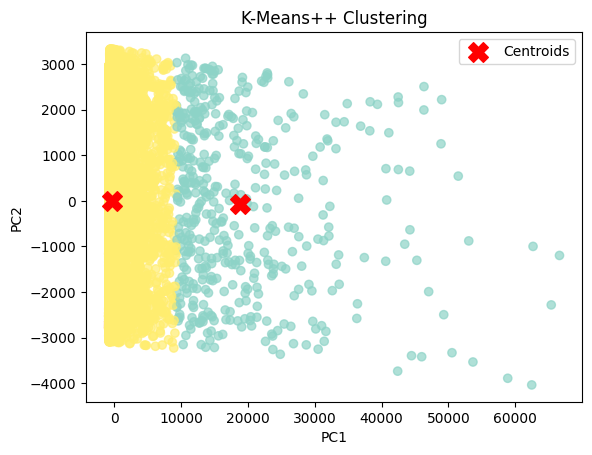

In [ ]:
# Plot kmeans results
plt.scatter(df_pca['PC1'], df_pca['PC2'], c=df_pca['Cluster'], cmap='Set3', marker='o', alpha=0.7)

plt.scatter(centroids_plus_plus['PC1'], centroids_plus_plus['PC2'], c='red', marker='X', s=200, label='Centroids')

plt.title('K-Means++ Clustering')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.show()

As we notice from the plot, although K-means++ typically leads to better cluster quality, we obtained the same result as using random initialization (Kmeans).

##### **2.3.4.  Ask an LLM (ChatGPT, Claude AI, Gemini, Perplexity, etc.) to recommend another clustering algorithm. Use that LLM to describe the workings of the algorithm, as well as its advantages and disadvantages compared to K-means and K-means++. Additionally, ask to implement the algorithm for you or utilize an existing version from a package. Apply that algorithm to your data and explain any differences you observe in the results compared to those obtained previously.**

Below, the responses from ChatGPT:

    Prompt: Reccomend a clustering algorithm (other than K-means and K-means++)    
**DBSCAN (Density-Based Spatial Clustering of Applications with Noise)**

DBSCAN is a density-based clustering algorithm that identifies clusters based on the density of data points in a region. It groups points closely packed together (high-density regions) and marks points in sparse regions as outliers.

    Prompt: Describe the workings of DBSCAN algorithm, as well as its advantages and disadvantages compared to K-means and K-means++.

**How DBSCAN Works**

**Parameters:**
- eps: The radius of a neighborhood around a point.
- min_samples: The minimum number of points required to form a dense region (a cluster).

**Key Concepts:**
- Core Point: A point with at least min_samples points within its eps radius.
- Border Point: A point within the eps radius of a core point but not itself a core point.
- Noise (Outlier): A point that is neither a core point nor a border point.

**Steps:**

- Step 1: Randomly pick an unvisited point.
- Step 2: If the point is a core point, form a new cluster by including all density-connected points (points reachable directly or indirectly within eps).
- Step 3: If the point is not a core point and does not satisfy the density criterion, mark it as noise (it may later be part of a cluster as a border point).
- Step 4: Repeat until all points have been visited.

**Output:**
Groups of points representing clusters.
Points labeled as noise or outliers.
sparse regions as outliers.

<br>

**Advantages of DBSCAN**

- **Shape Adaptability:** Can find clusters of arbitrary shapes (e.g., elongated, non-convex), unlike K-Means, which assumes spherical clusters.
- **No Need for k:** DBSCAN does not require the number of clusters to be predefined, whereas K-Means requires k to be specified beforehand.
- **Robustness to Outliers:** Automatically identifies outliers as noise and excludes them from clusters, unlike K-Means, which can be influenced heavily by outliers.
- **Density-Based:** Works well for datasets where clusters are defined by high-density regions separated by low-density regions.

**Disadvantages of DBSCAN**
- **Parameter Sensitivity:**
The choice of eps and min_samples can significantly affect the results.
Poor choices can lead to merging distinct clusters or splitting a single cluster.
- **Difficulty with Varying Densities:**
Struggles with datasets where clusters have varying densities or sizes, as a single eps value may not work well across the dataset.
- **Scalability:**
DBSCAN's computational complexity is $O(n^2)$ in the worst case (though indexing structures like KD-Trees can reduce this to $O(n \cdot \log n)$ for low-dimensional data). This makes it slower for large datasets compared to K-Means ($O(n⋅k⋅t)$, where
𝑡 is the number of iterations).
- **High-Dimensional Data:**
Performance can degrade in high-dimensional spaces where density estimates are less meaningful (the curse of dimensionality).

<br>

**Comparison to K-Means/K-Means++**

| **Aspect**               | **DBSCAN**                                   | **K-Means/K-Means++**                     |
|--------------------------|-----------------------------------------------|-------------------------------------------|
| **Cluster Shape**        | Arbitrary shapes (non-convex)                | Spherical clusters (convex assumption)    |
| **Cluster Count**        | Determined by density, no need for `k`.      | Must specify `k` in advance.              |
| **Outlier Detection**    | Explicitly identifies outliers.              | Sensitive to outliers; they affect centroids. |
| **Scalability**          | Slower for large datasets.                   | Generally faster for large datasets.      |
| **Parameter Sensitivity**| Sensitive to `eps` and `min_samples`.        | Sensitive to `k` and centroid initialization (less so with K-Means++). |
| **Varying Densities**    | Struggles with varying densities.            | Cannot handle varying densities.          |
| **Interpretability**     | Requires understanding of density thresholds.| Simpler and more intuitive.               |




<br>

**Applying the algorithm on our data**

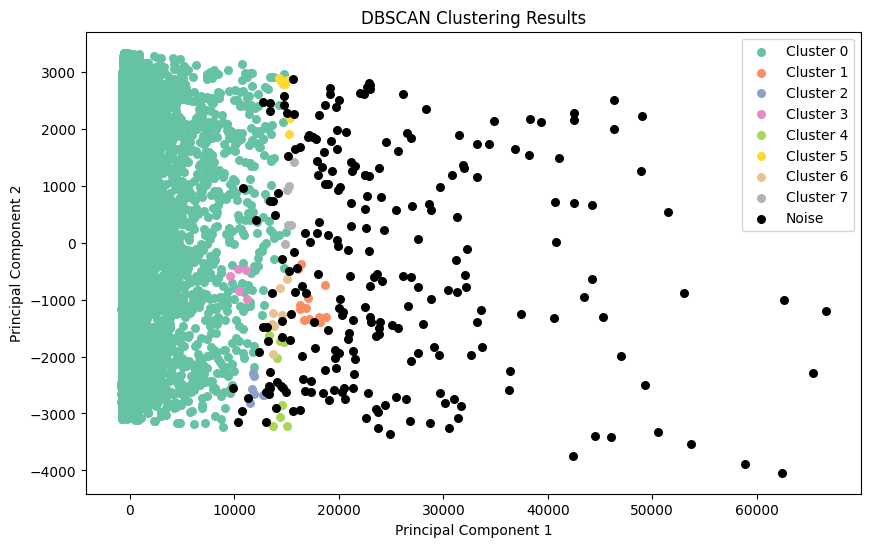

In [ ]:
df_pca_numpy = df_pca.to_numpy() if isinstance(df_pca, pd.DataFrame) else df_pca

dbscan = DBSCAN(eps=1000, min_samples = 5)
cluster_labels = dbscan.fit_predict(df_pca_numpy)

unique_labels = set(cluster_labels)
n_cluster = len([label for label in unique_labels if label != -1])
n_noise = list(cluster_labels).count(-1)

colors = [plt.cm.Set2(each) for each in np.linspace(0, 1, len(unique_labels))]
plt.figure(figsize = (10,6))

for k, col in zip(unique_labels, colors):
    if k == -1:
        col = [0, 0, 0, 1]  # Color noise points in black

    class_member_mask = (cluster_labels == k)
    xy = df_pca_numpy[class_member_mask]  # Select points that belong to the current cluster

    plt.scatter(xy[:, 0], xy[:, 1], c=[col], label=f'Cluster {k}' if k != -1 else 'Noise', s=30)

# Add labels and legend
plt.title('DBSCAN Clustering Results')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.show()

### **2.4 Best Algorithm**

###### **2.4.1 Set the number of clusters to the optimal number *k<sub>opt</sub>* based on any of the methods previously.**

Observing the elbow method and the average silhouette score plots we can conclude that the optimal number of clusters k<sub>opt</sub> for both the K-means and K-means++ algorithms is **2**.

On the other hand, for the DBSCAN algorithm, the number of clusters is not an hyperparameter, instead it depends on how the data points are distributed. After trying different values of eps and min_samples, we set them to eps=1000 and min_samples=5, this means that clusters contain at least 5 samples and the distance between a point in the cluster and the one closest to it that belongs to the same cluster is at most 1000.

##### **2.4.2 Select three distinct metrics to assess the quality of the clusters. Describe each metric in detail, including the specific aspects they evaluate to determine the effectiveness of the clustering model.**

To assess the quality of the clusters, we choose to utilize the **Average Silhouette Score**, D**avies–Bouldin Index** and the **Calinski-Harabasz Index**.

<br>

**Average Silhouette Score**

\begin{align}
\text{Average Silhouette Score} = \frac{1}{N}\sum_{i=1}^{N}s(i)
\end{align}

The **Average Silhouette Score** is the average of all the silhouette scores computed on each data point in the dataset. Here *s(i)* is defined as:


\begin{align}
s(i) = \frac{b(i) - a(i)}{\max\{a(i), b(i)\}}.
\end{align}


In the equation above *a(i)* is the mean distance between *i* and all the other data points in its cluster, while *b(i)* is the smallest mean distance between *i* and all points in any other cluster.

Hence this value ranges between -1 and +1 and measures how similar a point is with respect to is cluster and how much it is more similar to it than any other cluster.

<br>

**Calinski-Harabasz Index**


The **Calinski–Harabasz Index** is defined as the ratio of the between-cluster separation (*BCSS*) to the within-cluster dispersion (*WCSS*), normalized by their number of degrees of freedom:

\begin{align}
CH = \frac{BCSS/(k-1)}{WCSS/(n-k)}.
\end{align}

Where *BCSS* is the weighted sum of squares euclidean distances between each cluster's centroid and the dataset mean, this value measures the level of separation between the clusters, and *WCSS* is the sum of squares euclidean distances between the data points and the centroids of the clusters to which they belong, a smaller WCCS implies an higher compactness in the clusters.

This values are then divided by their grades of freedom, respectively (k-1) and (n-k), to normalize the values.

<br>

**Davies–Bouldin index**


The **Davies-Bouldin index** is defined as:

\begin{align}
DB = \frac{1}{k}\sum_{i=1}^{k}\max_{j \neq i}(\frac{S_i+S_j}{M_{ij}})
\end{align}


Where *S<sub>i</sub>* and *S<sub>j</sub>* are the average distance of points in a cluster and the cluster's centroid and *M<sub>ij</sub>* is the distance between the centroids of the j-th and i-th clusters.

Smaller *DB* values indicate that each cluster has an higher compactness level and that the distance between different clusters is bigger.

##### **2.4.3 Apply the three clustering algorithms used in the prior section to partition the data into *k<sub>opt</sub>* clusters. Then, evaluate each model's clustering quality using the selected metrics. Summarize your findings by comparing the results of each algorithm based on the metric evaluations.**

In [ ]:
# Initialize dictionary
metrics = {'kmeans':[], 'kmeans++': [], 'DBSCAN':[]}

# KMEANS++
df_pca.drop(columns=['Cluster'], inplace=True)
centroids_plus_plus, clusters_plus_plus, _, __  = kmeans(df_pca, 2, plus=True, seed = 42)

# find metrics
metrics['kmeans++'].append(silhouette_score(df_pca, clusters_plus_plus['Cluster']))
metrics['kmeans++'].append(calinski_harabasz_score(df_pca, clusters_plus_plus['Cluster']))
metrics['kmeans++'].append(davies_bouldin_score(df_pca, clusters_plus_plus['Cluster']))


# KMEANS
df_pca.drop(columns=['Cluster'], inplace=True)     # This is used to remove previous cluster assignment
centroids_kmeans, clusters_kmeans, centroids_history, clusters_history = kmeans(df_pca, 2, seed=42)

metrics['kmeans'].append(silhouette_score(df_pca, clusters_kmeans['Cluster']))
metrics['kmeans'].append(calinski_harabasz_score(df_pca, clusters_kmeans['Cluster']))
metrics['kmeans'].append(davies_bouldin_score(df_pca, clusters_kmeans['Cluster']))


# DBSCAN

# Exclude noise points
core_points_mask = cluster_labels != -1
core_points = df_pca_numpy[core_points_mask]
core_labels = cluster_labels[core_points_mask]

metrics['DBSCAN'].append(silhouette_score(core_points, core_labels))
metrics['DBSCAN'].append(calinski_harabasz_score(core_points, core_labels))
metrics['DBSCAN'].append(davies_bouldin_score(core_points, core_labels))


In [ ]:
metrics = pd.DataFrame(metrics, index=['Silhouette Score', 'Calinski-Harabasz Index', 'Davies-Bouldin Index'])
metrics

,kmeans,kmeans++,DBSCAN
Silhouette Score,0.860735,0.860735,0.755232
Calinski-Harabasz Index,25666.762782,25666.762782,304.804772
Davies-Bouldin Index,0.520200,0.520200,0.560363


As we can see from the "*metrics* " DataFrame,
- **Kmeans** and **Kmeans++** have identical performance, with high *Silhouette Score*, high *Calinski-Harabasz Index* and moderate *Davies-Bouldin Index*.

- As for **DBSCAN**, the *Silhouette Score* is still relatively high (though lower than the other two algorithms), *Calinski-Harabasz Index* is low and *Davies-Bouldin Index* is moderate and slightly higher than the other two algorithms.

## **3. Bonus Question**

In [ ]:
# Visualizza l'animazione
plot_kmeans_animation(df_pca, k=2, centroids_history=centroids_history[:-1], clusters_history=clusters_history)